# 🧠 BRAIN TUMOR DETECTION MODEL USING YOLOv12 🦠


## 📦 Importing Required Libraries

In [1]:
import os
import glob
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
from ultralytics import YOLO
import cv2
import numpy as np
import random

## ⚙️ Configuration and Hyperparameters

In [ ]:
DATASET_PATH = 'dataset/img-to-numplate/'
YAML_FILE = os.path.join(DATASET_PATH, 'data.yaml')

MODEL_NAME = 'yolo11n.pt'
EPOCHS = 500
IMG_SIZE = 640
BATCH_SIZE = 32
CONF_THRESHOLD = 0.25
IOU_THRESHOLD = 0.45

Project_Name = 'Image to Number Plate Detection'
RUN_NAME = 'YOLOv12_'

TRAIN_PROJECT_NAME = Project_Name
TRAIN_RUN_NAME = 'train_'+RUN_NAME + "32"

PREDICT_PROJECT_NAME = Project_Name
PREDICT_RUN_NAME = 'prediction_'+RUN_NAME

num_images_to_predict = 10

## 🏋️ Training the YOLOv11 Model

🤖 Defining Model 📦

In [3]:
model = YOLO("yolov12n.pt", task='detect')

🧑‍🏫 Training 🏃‍♂️

In [4]:
results = model.train(
    data=YAML_FILE,
    epochs=EPOCHS,
    imgsz=IMG_SIZE,
    batch=BATCH_SIZE,
    project=TRAIN_PROJECT_NAME,
    name=TRAIN_RUN_NAME,
    amp=True,
    patience=32,
    pretrained=True,
    optimizer='auto',
    optimize=True,
)

print("Training finished. Model saved to:", model.trainer.save_dir)

BEST_MODEL_PATH = os.path.join(model.trainer.save_dir, 'weights', 'best.pt')
print("Best model weights path:", BEST_MODEL_PATH)

New https://pypi.org/project/ultralytics/8.3.176 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.168 🚀 Python-3.12.3 torch-2.7.1+cu126 CUDA:0 (NVIDIA GeForce RTX 3060, 11913MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset/img-to-numplate/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=500, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov12n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train_YOLOv12_32, nbs=64, nms=

train: Scanning /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/train/labels.cache... 1350 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1350/1350 [00:00<?, ?it/s]


val: Fast image access ✅ (ping: 0.1±0.0 ms, read: 836.9±500.2 MB/s, size: 1573.2 KB)


val: Scanning /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/val/labels.cache... 385 images, 0 backgrounds, 0 corrupt: 100%|██████████| 385/385 [00:00<?, ?it/s]

val: /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/val/images/Vehicle1644.jpg: corrupt JPEG restored and saved


Plotting labels to Image to Number Plate Detection/train_YOLOv12_32/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0005), 119 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to Image to Number Plate Detection/train_YOLOv12_32
Starting training for 500 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/500      6.24G      2.159      4.083      1.986         54        640:  14%|█▍        | 6/43 [00:02<00:14,  2.61it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
      1/500      6.25G      1.743      3.888      1.647         68        640:  86%|████████▌ | 37/43 [00:13<00:02,  2.78it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
      1/500       6.3G       1.69      3.703      1.578         12        640: 100%|██████████| 43/43 [00:15<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.30it/s]

                   all        385        403      0.924      0.606       0.78      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/500      6.14G      1.449      1.709      1.318         49        640:  84%|████████▎ | 36/43 [00:12<00:02,  2.84it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
      2/500      6.19G      1.452       1.67       1.32         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.49it/s]

                   all        385        403      0.914      0.767      0.878      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/500      6.18G      1.474      1.393      1.369         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.35it/s]

                   all        385        403      0.795      0.809      0.831      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/500      6.14G      1.485      1.271       1.38         57        640:  21%|██        | 9/43 [00:03<00:11,  2.86it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
      4/500      6.19G      1.461      1.177      1.387         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.62it/s]

                   all        385        403        0.6      0.524      0.541      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/500      6.15G      1.473      1.095      1.437         65        640:  44%|████▍     | 19/43 [00:06<00:08,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
      5/500      6.18G      1.459      1.048      1.433         17        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.63it/s]

                   all        385        403      0.451      0.297      0.268      0.121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/500      6.14G      1.451     0.9733      1.439         66        640:  72%|███████▏  | 31/43 [00:10<00:04,  2.84it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
      6/500      6.19G       1.45      0.954      1.446         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.63it/s]

                   all        385        403       0.84      0.675      0.763      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/500      6.18G      1.461      0.946      1.484          9        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.72it/s]

                   all        385        403      0.664       0.65      0.711      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/500      6.14G      1.451     0.8966      1.485         52        640:  14%|█▍        | 6/43 [00:02<00:13,  2.81it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
      8/500      6.19G      1.419     0.8524      1.494         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.75it/s]

                   all        385        403       0.91       0.85      0.889       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/500      6.15G      1.434     0.8413      1.474         66        640:  49%|████▉     | 21/43 [00:07<00:07,  2.81it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
      9/500      6.18G      1.431      0.831      1.474         12        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.82it/s]

                   all        385        403      0.849      0.799      0.818       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/500      6.14G      1.529     0.8096      1.509         67        640:   2%|▏         | 1/43 [00:00<00:14,  2.87it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     10/500      6.19G      1.427     0.7999      1.483         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.72it/s]

                   all        385        403      0.893      0.851      0.888      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/500      6.16G       1.46     0.8344      1.496         57        640:  56%|█████▌    | 24/43 [00:08<00:06,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     11/500      6.18G      1.433     0.8118      1.498         16        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.80it/s]

                   all        385        403      0.887      0.918      0.923      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/500      6.15G      1.419     0.7585      1.518         60        640:  53%|█████▎    | 23/43 [00:08<00:07,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     12/500      6.15G      1.403     0.7552      1.513         59        640:  70%|██████▉   | 30/43 [00:10<00:04,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     12/500      6.19G      1.402     0.7552      1.496         16        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.76it/s]

                   all        385        403      0.859      0.859      0.898      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/500      6.18G      1.395      0.743      1.508         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.75it/s]

                   all        385        403      0.904      0.819      0.898      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/500      6.14G      1.412     0.7705      1.489         59        640:  58%|█████▊    | 25/43 [00:08<00:06,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     14/500      6.19G      1.423     0.7682      1.486          8        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.77it/s]

                   all        385        403      0.835      0.803       0.86      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/500      6.18G      1.429     0.7433      1.531         56        640:  30%|███       | 13/43 [00:04<00:10,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     15/500      6.21G      1.404     0.7488      1.495         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.81it/s]

                   all        385        403       0.68      0.692      0.665      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/500      6.14G      1.393     0.7813      1.469         68        640:  53%|█████▎    | 23/43 [00:08<00:07,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     16/500      6.18G      1.379     0.7511      1.481          7        640: 100%|██████████| 43/43 [00:14<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.868      0.722      0.812      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/500      6.15G      1.405     0.7334      1.508         65        640:  88%|████████▊ | 38/43 [00:13<00:01,  2.86it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     17/500      6.18G      1.409     0.7334      1.508         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.84it/s]

                   all        385        403       0.95      0.878      0.938      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/500      6.19G        1.4     0.7257      1.477         16        640: 100%|██████████| 43/43 [00:14<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.03it/s]

                   all        385        403       0.88      0.886      0.927      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/500      6.15G      1.374     0.6971      1.468         67        640:  16%|█▋        | 7/43 [00:02<00:12,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     19/500      6.15G      1.403     0.7222      1.497         67        640:  74%|███████▍  | 32/43 [00:11<00:03,  2.90it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     19/500      6.18G      1.398     0.7222      1.491         15        640: 100%|██████████| 43/43 [00:14<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.11it/s]

                   all        385        403       0.87      0.933      0.949      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/500      6.19G      1.367     0.6941      1.468         11        640: 100%|██████████| 43/43 [00:14<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.02it/s]

                   all        385        403      0.937      0.903      0.943      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/500      6.15G      1.376     0.7108      1.502         58        640:   7%|▋         | 3/43 [00:01<00:13,  2.96it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     21/500      6.18G      1.364     0.6986      1.463         13        640: 100%|██████████| 43/43 [00:14<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.04it/s]

                   all        385        403      0.925      0.819      0.881      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/500      6.15G      1.363     0.6735      1.478         58        640:  28%|██▊       | 12/43 [00:04<00:10,  2.94it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     22/500      6.19G      1.347     0.6751      1.465         12        640: 100%|██████████| 43/43 [00:14<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.04it/s]

                   all        385        403      0.898      0.875      0.906      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/500      6.18G      1.363     0.6748      1.476          6        640: 100%|██████████| 43/43 [00:14<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.03it/s]

                   all        385        403      0.935      0.928      0.962      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/500      6.14G      1.454     0.7078      1.503         56        640:   7%|▋         | 3/43 [00:01<00:13,  2.98it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     24/500      6.19G      1.373     0.6738       1.47         10        640: 100%|██████████| 43/43 [00:14<00:00,  3.05it/s]
libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.16it/s]

                   all        385        403      0.964      0.926      0.962      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/500      6.18G      1.324     0.6662      1.444          6        640: 100%|██████████| 43/43 [00:14<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.11it/s]

                   all        385        403      0.939      0.957      0.969      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/500      6.19G      1.328     0.6542      1.441         11        640: 100%|██████████| 43/43 [00:14<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.09it/s]

                   all        385        403      0.927      0.921      0.954      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/500      6.15G      1.381     0.6618      1.471         56        640:  42%|████▏     | 18/43 [00:06<00:08,  3.02it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     27/500      6.18G      1.346     0.6524      1.465         11        640: 100%|██████████| 43/43 [00:14<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.08it/s]

                   all        385        403      0.944       0.92      0.951      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/500      6.14G      1.315     0.6379      1.461         65        640:   9%|▉         | 4/43 [00:01<00:13,  3.00it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     28/500      6.19G      1.331      0.638      1.453         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.84it/s]

                   all        385        403      0.927      0.916      0.947      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/500      6.16G      1.319     0.6515      1.432         50        640:  56%|█████▌    | 24/43 [00:08<00:06,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     29/500      6.16G      1.318     0.6464      1.438         68        640:  77%|███████▋  | 33/43 [00:11<00:03,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     29/500      6.18G      1.317     0.6431      1.446         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.959      0.928      0.968      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/500      6.14G      1.326     0.6402      1.451         51        640:  74%|███████▍  | 32/43 [00:11<00:03,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     30/500      6.19G      1.327     0.6416      1.443         12        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.79it/s]

                   all        385        403      0.891      0.819      0.869      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/500      6.15G      1.313     0.6417      1.431         54        640:  77%|███████▋  | 33/43 [00:11<00:03,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     31/500      6.18G      1.318     0.6411      1.442         12        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.918      0.943      0.959      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/500      6.19G      1.336     0.6419      1.473         13        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403       0.93       0.95      0.954      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/500      6.15G       1.34     0.6505      1.418         61        640:   9%|▉         | 4/43 [00:01<00:13,  2.86it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     33/500      6.15G      1.318     0.6294      1.446         62        640:  70%|██████▉   | 30/43 [00:10<00:04,  2.86it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     33/500      6.19G      1.316     0.6368      1.441         19        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.84it/s]

                   all        385        403      0.937      0.953      0.969      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/500      6.19G       1.32     0.6444      1.449         13        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.89it/s]

                   all        385        403       0.94      0.937      0.969      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/500      6.18G      1.331     0.6362      1.448         13        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.944      0.955      0.972      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/500      6.14G      1.288     0.6086      1.415         72        640:  58%|█████▊    | 25/43 [00:08<00:06,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     36/500      6.14G      1.282      0.613      1.422         61        640:  88%|████████▊ | 38/43 [00:13<00:01,  2.81it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     36/500      6.19G      1.282     0.6082      1.419         15        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.929      0.874      0.938      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/500      6.18G      1.305     0.6266      1.438         16        640: 100%|██████████| 43/43 [00:14<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.84it/s]

                   all        385        403      0.924      0.926      0.941       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/500      6.14G      1.253     0.6039      1.412         59        640:  26%|██▌       | 11/43 [00:03<00:11,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     38/500      6.14G      1.292     0.6165      1.432         54        640:  70%|██████▉   | 30/43 [00:10<00:04,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     38/500      6.19G      1.296     0.6139      1.425         13        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.81it/s]

                   all        385        403      0.922      0.945      0.957      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/500      6.18G      1.293     0.6123      1.447          6        640: 100%|██████████| 43/43 [00:14<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.83it/s]

                   all        385        403      0.755      0.583      0.634      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/500      6.14G      1.274     0.6106      1.432         71        640:  40%|███▉      | 17/43 [00:06<00:09,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     40/500      6.14G      1.293     0.6112      1.444         60        640:  84%|████████▎ | 36/43 [00:12<00:02,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     40/500      6.19G      1.276     0.6064       1.44          9        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.929      0.942      0.958       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/500      6.18G      1.293     0.6102      1.431         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.936      0.907      0.953      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/500      6.14G      1.307     0.6222      1.477         70        640:  21%|██        | 9/43 [00:03<00:11,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     42/500      6.19G      1.306      0.614      1.429         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.945      0.921      0.949      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/500      6.15G       1.28     0.6057      1.425         73        640:  58%|█████▊    | 25/43 [00:08<00:06,  2.73it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     43/500      6.18G      1.276     0.6011      1.429         12        640: 100%|██████████| 43/43 [00:15<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.87it/s]

                   all        385        403      0.947      0.934      0.967      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/500      6.14G       1.31     0.6151      1.454         61        640:  12%|█▏        | 5/43 [00:01<00:13,  2.86it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     44/500      6.18G      1.287     0.5981       1.44          9        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.963      0.912      0.959      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/500      6.15G      1.333     0.6368      1.468         62        640:  26%|██▌       | 11/43 [00:03<00:11,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     45/500      6.15G      1.302     0.6144      1.431         64        640:  70%|██████▉   | 30/43 [00:10<00:04,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     45/500      6.18G      1.287     0.6059      1.422         16        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.88it/s]

                   all        385        403      0.942      0.911      0.953       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/500      6.19G      1.278     0.5956      1.428         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.82it/s]

                   all        385        403       0.96      0.935      0.971      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/500      6.15G      1.273     0.5821      1.434         56        640:  28%|██▊       | 12/43 [00:04<00:10,  2.86it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     47/500      6.18G       1.28      0.591      1.424         13        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.87it/s]

                   all        385        403      0.951      0.919      0.965      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/500      6.14G      1.269     0.5931      1.428         71        640:   9%|▉         | 4/43 [00:01<00:13,  2.81it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     48/500      6.19G      1.275     0.5923       1.42         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.88it/s]

                   all        385        403      0.927       0.97       0.98      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/43 [00:00<?, ?it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     49/500      6.15G      1.257     0.5831      1.413         59        640:  91%|█████████ | 39/43 [00:13<00:01,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     49/500      6.18G      1.252     0.5814       1.41         12        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.89it/s]

                   all        385        403      0.947      0.943       0.97       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/500      6.14G      1.242     0.5772      1.408         60        640:  70%|██████▉   | 30/43 [00:10<00:04,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     50/500      6.19G      1.261     0.5863      1.418         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.89it/s]

                   all        385        403      0.944      0.943      0.969      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/500      6.18G      1.249     0.5765      1.442         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]

                   all        385        403      0.957      0.929       0.97      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/500      6.14G      1.273     0.5688      1.467         62        640:  51%|█████     | 22/43 [00:07<00:07,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     52/500      6.19G       1.26     0.5653      1.442         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.953      0.945      0.973      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/500      6.15G       1.25     0.5964      1.441         67        640:  21%|██        | 9/43 [00:03<00:12,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     53/500      6.15G      1.251     0.5702      1.419         49        640:  93%|█████████▎| 40/43 [00:14<00:01,  2.86it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     53/500      6.18G      1.251     0.5707      1.414         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.91it/s]

                   all        385        403      0.961      0.931      0.976       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/500      6.15G      1.236     0.5645       1.43         47        640:  65%|██████▌   | 28/43 [00:09<00:05,  2.80it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     54/500      6.19G      1.237     0.5704      1.418         13        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.88it/s]

                   all        385        403      0.949      0.923      0.959      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/500      6.18G      1.235     0.5663      1.409         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.91it/s]

                   all        385        403      0.957      0.958      0.976      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/500      6.19G      1.239     0.5679      1.391         15        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.945      0.963      0.971      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/500      6.15G      1.231     0.5409      1.361         59        640:  12%|█▏        | 5/43 [00:01<00:13,  2.81it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     57/500      6.18G      1.239     0.5607      1.414         12        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.92it/s]

                   all        385        403      0.963      0.953      0.983      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/500      6.14G      1.221     0.5682      1.379         74        640:  35%|███▍      | 15/43 [00:05<00:09,  2.84it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     58/500      6.19G      1.241     0.5804      1.398         12        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.937      0.938      0.973      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/500      6.15G      1.225     0.5646      1.396         65        640:  42%|████▏     | 18/43 [00:06<00:08,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     59/500      6.18G      1.216     0.5627      1.393         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.89it/s]

                   all        385        403      0.943      0.937      0.966      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/500      6.14G       1.23     0.5568      1.411         65        640:  51%|█████     | 22/43 [00:07<00:07,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     60/500      6.14G      1.225     0.5616       1.41         57        640:  79%|███████▉  | 34/43 [00:12<00:03,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     60/500      6.19G      1.222     0.5581      1.402         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.89it/s]

                   all        385        403      0.957      0.933      0.957      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/500      6.15G        1.2     0.5459      1.366         61        640:  93%|█████████▎| 40/43 [00:14<00:01,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     61/500      6.18G      1.211     0.5484      1.373         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.81it/s]

                   all        385        403      0.953      0.955      0.974      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/500      6.14G      1.224     0.5523      1.388         59        640:  74%|███████▍  | 32/43 [00:11<00:03,  2.80it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     62/500      6.19G      1.215     0.5488      1.394         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.89it/s]

                   all        385        403       0.94       0.94      0.959      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/500      6.18G      1.202     0.5442       1.39         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]

                   all        385        403      0.941      0.954      0.969      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/500      6.14G      1.224     0.5597      1.396         79        640:  98%|█████████▊| 42/43 [00:14<00:00,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     64/500      6.18G       1.23     0.5628      1.405          7        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]

                   all        385        403      0.922      0.943      0.955      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/500      6.18G      1.198      0.538      1.398          8        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.91it/s]

                   all        385        403       0.91      0.955      0.962      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/500      6.14G      1.193     0.5567      1.383         54        640:  56%|█████▌    | 24/43 [00:08<00:06,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     66/500      6.19G      1.208     0.5585      1.396         17        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.82it/s]

                   all        385        403      0.939      0.906      0.951      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/500      6.16G      1.219     0.5802      1.412         57        640:   9%|▉         | 4/43 [00:01<00:13,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     67/500      6.18G      1.203     0.5433       1.39         12        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]

                   all        385        403      0.943      0.955      0.975      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/500      6.19G      1.195     0.5541      1.374          9        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.88it/s]

                   all        385        403      0.936       0.95      0.972      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/500      6.15G      1.155      0.511      1.355         52        640:  35%|███▍      | 15/43 [00:05<00:09,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     69/500      6.18G      1.186     0.5319      1.365         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.80it/s]

                   all        385        403      0.952       0.95      0.972      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/500      6.14G      1.187     0.5261      1.358         60        640:  37%|███▋      | 16/43 [00:05<00:09,  2.82it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     70/500      6.14G      1.189     0.5328      1.343         61        640:  91%|█████████ | 39/43 [00:13<00:01,  2.86it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     70/500      6.19G      1.189     0.5303      1.342         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.944      0.922      0.966       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/500      6.18G      1.174     0.5306      1.369         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.89it/s]

                   all        385        403      0.948      0.955       0.97       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/500      6.14G      1.156     0.5259      1.363         56        640:  21%|██        | 9/43 [00:03<00:11,  2.84it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     72/500      6.14G      1.166     0.5292      1.367         64        640:  67%|██████▋   | 29/43 [00:10<00:04,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     72/500      6.19G      1.164     0.5328      1.364          9        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.944      0.955      0.966      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/500      6.18G      1.166      0.524      1.361         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.82it/s]

                   all        385        403      0.935      0.927       0.96       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/500      6.14G      1.102     0.5053      1.311         65        640:   9%|▉         | 4/43 [00:01<00:13,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     74/500      6.14G      1.167     0.5223      1.358         67        640:  74%|███████▍  | 32/43 [00:11<00:03,  2.83it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     74/500      6.19G      1.172      0.526      1.369          9        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.929      0.937      0.967      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/500      6.15G      1.131     0.5217      1.338         57        640:  65%|██████▌   | 28/43 [00:09<00:05,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     75/500      6.18G      1.133     0.5216      1.338         15        640: 100%|██████████| 43/43 [00:14<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.81it/s]

                   all        385        403      0.931       0.94      0.964      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/500      6.14G      1.135     0.5076      1.314         61        640:  63%|██████▎   | 27/43 [00:09<00:05,  2.84it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     76/500      6.19G      1.159     0.5148      1.339         12        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]

                   all        385        403      0.948       0.96      0.974      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/500      6.18G       1.15     0.5146      1.344         12        640: 100%|██████████| 43/43 [00:14<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.78it/s]

                   all        385        403      0.932      0.946       0.97      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/500      6.14G      1.162     0.5393      1.352         70        640:  95%|█████████▌| 41/43 [00:14<00:00,  2.84it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     78/500      6.19G       1.17     0.5405      1.358         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.957      0.935      0.968       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/500      6.18G      1.155     0.5204      1.351         13        640: 100%|██████████| 43/43 [00:14<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.945      0.955      0.977      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/500      6.14G        1.2     0.5387      1.394         61        640:  26%|██▌       | 11/43 [00:03<00:11,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     80/500      6.18G      1.168     0.5336      1.375          7        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.927      0.939      0.954      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/43 [00:00<?, ?it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     81/500      6.18G      1.155     0.5278      1.382         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.75it/s]

                   all        385        403      0.937      0.918       0.95       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/500      6.14G       1.08     0.4863      1.332         65        640:   7%|▋         | 3/43 [00:01<00:14,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     82/500      6.18G      1.116     0.5038      1.366          8        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.932      0.924      0.943      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/500      6.15G      1.122     0.5319      1.357         58        640:  14%|█▍        | 6/43 [00:02<00:12,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     83/500      6.15G      1.132      0.512       1.34         68        640:  79%|███████▉  | 34/43 [00:11<00:03,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     83/500      6.18G      1.134     0.5172      1.339         11        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.82it/s]

                   all        385        403      0.942      0.967      0.975      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/500      6.19G      1.158      0.531      1.342         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]

                   all        385        403      0.924      0.965      0.969      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/500      6.18G      1.149     0.5088      1.359         14        640: 100%|██████████| 43/43 [00:14<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.91it/s]

                   all        385        403      0.956      0.948      0.963       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/500      6.14G      1.128     0.4889      1.341         65        640:  26%|██▌       | 11/43 [00:03<00:11,  2.85it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     86/500      6.19G      1.128     0.5048      1.333          9        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.85it/s]

                   all        385        403      0.924      0.953      0.964      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/500      6.18G      1.137     0.5177      1.337          8        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]

                   all        385        403      0.937      0.963      0.976       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/500      6.14G      1.152     0.5206      1.353         54        640:  49%|████▉     | 21/43 [00:07<00:07,  2.84it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     88/500      6.14G      1.135     0.5206      1.341         67        640:  63%|██████▎   | 27/43 [00:09<00:05,  2.84it/s]libpng warning: iCCP: profile 'ICC Profile': 0h: PCS illuminant is not D50
     88/500      6.19G      1.131      0.516      1.342         10        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.86it/s]

                   all        385        403      0.942      0.962      0.967       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/500      6.18G      1.111     0.5107      1.345         13        640: 100%|██████████| 43/43 [00:14<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.87it/s]

                   all        385        403      0.952      0.942      0.971      0.576
EarlyStopping: Training stopped early as no improvement observed in last 32 epochs. Best results observed at epoch 57, best model saved as best.pt.
To update EarlyStopping(patience=32) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



89 epochs completed in 0.415 hours.
Optimizer stripped from Image to Number Plate Detection/train_YOLOv12_32/weights/last.pt, 5.4MB
Optimizer stripped from Image to Number Plate Detection/train_YOLOv12_32/weights/best.pt, 5.4MB

Validating Image to Number Plate Detection/train_YOLOv12_32/weights/best.pt...
Ultralytics 8.3.168 🚀 Python-3.12.3 torch-2.7.1+cu126 CUDA:0 (NVIDIA GeForce RTX 3060, 11913MiB)
YOLOv12n summary (fused): 159 layers, 2,526,971 parameters, 0 gradients, 5.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.06it/s]


                   all        385        403      0.963      0.953      0.983       0.61
Speed: 0.1ms preprocess, 2.3ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to Image to Number Plate Detection/train_YOLOv12_32
Training finished. Model saved to: Image to Number Plate Detection/train_YOLOv12_32
Best model weights path: Image to Number Plate Detection/train_YOLOv12_32/weights/best.pt


## 🔍 Setting Up for Predictions and Visualization

In [14]:
import random

print("\nStarting prediction on test images and visualization...")

trained_model = YOLO(BEST_MODEL_PATH)

TEST_IMAGES_DIR = os.path.join(DATASET_PATH, 'test', 'images')
TEST_LABELS_DIR = os.path.join(DATASET_PATH, 'test', 'labels')

test_image_files = glob.glob(os.path.join(TEST_IMAGES_DIR, '*.jpg')) + \
                   glob.glob(os.path.join(TEST_IMAGES_DIR, '*.jpeg')) + \
                   glob.glob(os.path.join(TEST_IMAGES_DIR, '*.png'))
random.shuffle(test_image_files)

num_images_to_predict = 30
if num_images_to_predict > 0:                   
    test_image_files = test_image_files[:num_images_to_predict]


Starting prediction on test images and visualization...


## 🏷️ Loading Class Names

In [15]:
def load_class_names(yaml_path):
    import yaml
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    return data['names']

class_names = load_class_names(YAML_FILE)

## 🖍️ Helper Function to Draw Annotations

In [16]:
def draw_annotations(image, annotations, class_names, color=(0, 255, 0), is_gt=False):
    img_height, img_width, _ = image.shape
    display_image = image.copy()

    for ann in annotations:
        class_id = int(ann[0])
        
        if len(ann) >= 5: # Check if there are at least 5 elements (class_id + 4 coords)
            x_center, y_center, width, height = ann[1:5]
        else:
            # Handle cases where annotation might be malformed or incomplete
            print(f"Warning: Annotation {ann} does not have enough values for bounding box. Skipping.")
            continue

        x_min = int((x_center - width / 2) * img_width)
        y_min = int((y_center - height / 2) * img_height)
        x_max = int((x_center + width / 2) * img_width)
        y_max = int((y_center + height / 2) * img_height)

        cv2.rectangle(display_image, (x_min, y_min), (x_max, y_max), color, 2)

        label = class_names[class_id]
        if not is_gt and len(ann) > 5:
            confidence = ann[5]
            label += f' {confidence:.2f}'

        cv2.putText(display_image, label, (x_min, y_min - 10), 
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return display_image

## 🖼️ Predict and Visualize Each Test Image


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle41.jpg: 640x480 2 License Plates, 7.9ms
Speed: 1.2ms preprocess, 7.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)


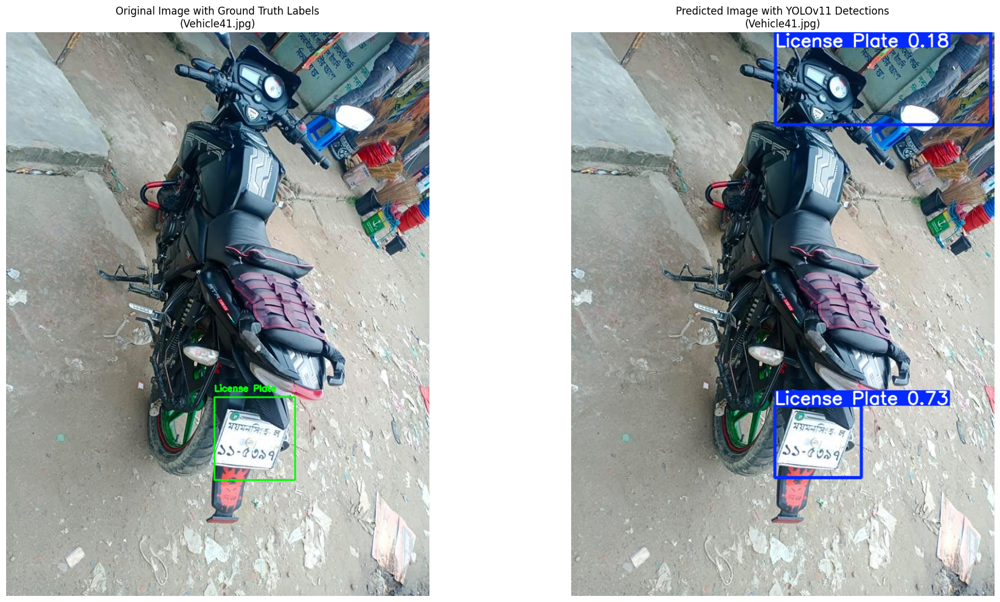


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle4.jpg: 320x640 1 License Plate, 8.2ms
Speed: 0.9ms preprocess, 8.2ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 640)


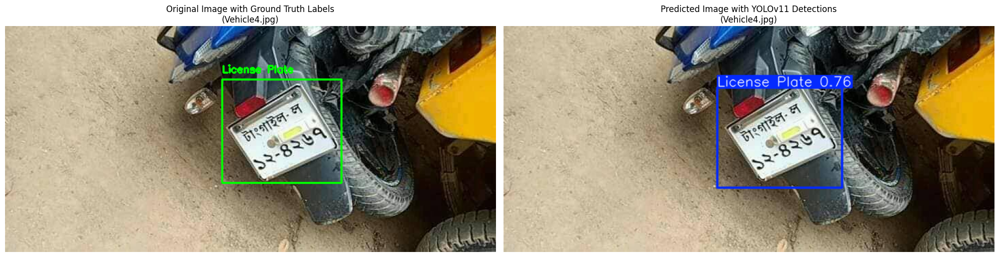


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle552.jpg: 640x512 1 License Plate, 42.2ms
Speed: 1.4ms preprocess, 42.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 512)


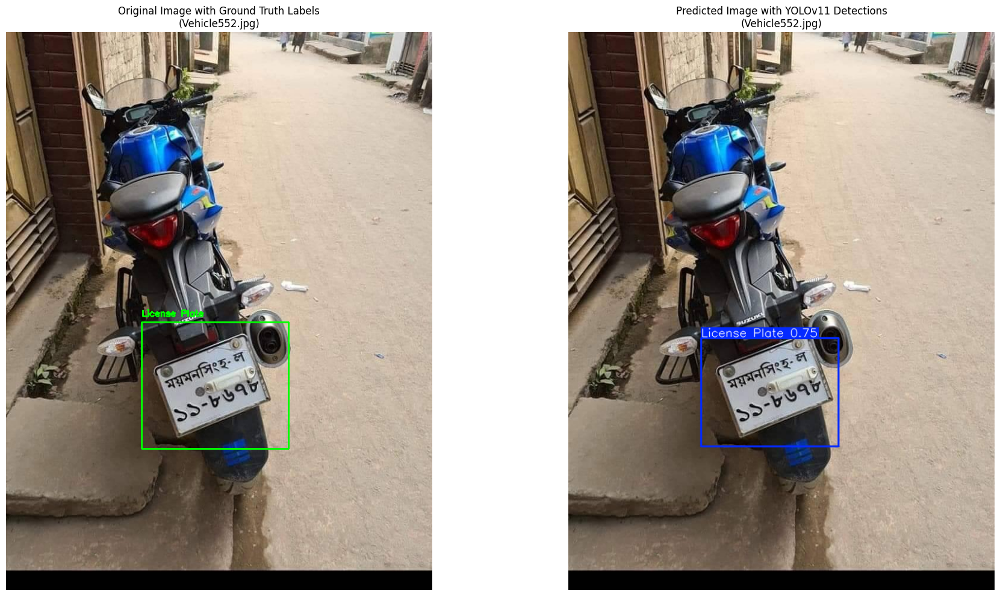


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle13.jpg: 384x640 1 License Plate, 8.7ms
Speed: 1.1ms preprocess, 8.7ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


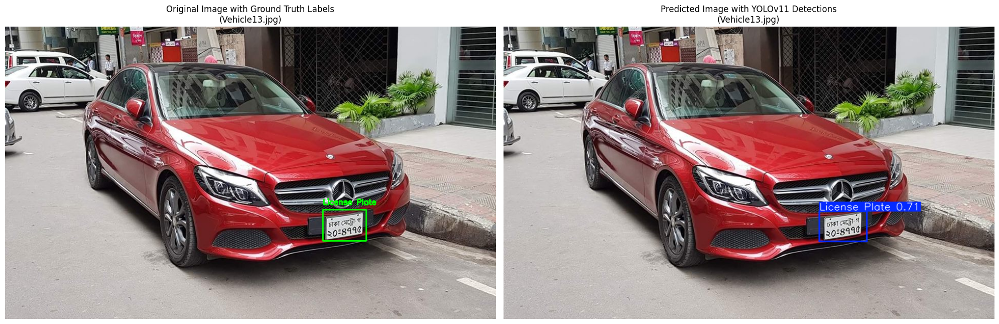


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1431.jpg: 640x352 1 License Plate, 8.7ms
Speed: 1.0ms preprocess, 8.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 352)


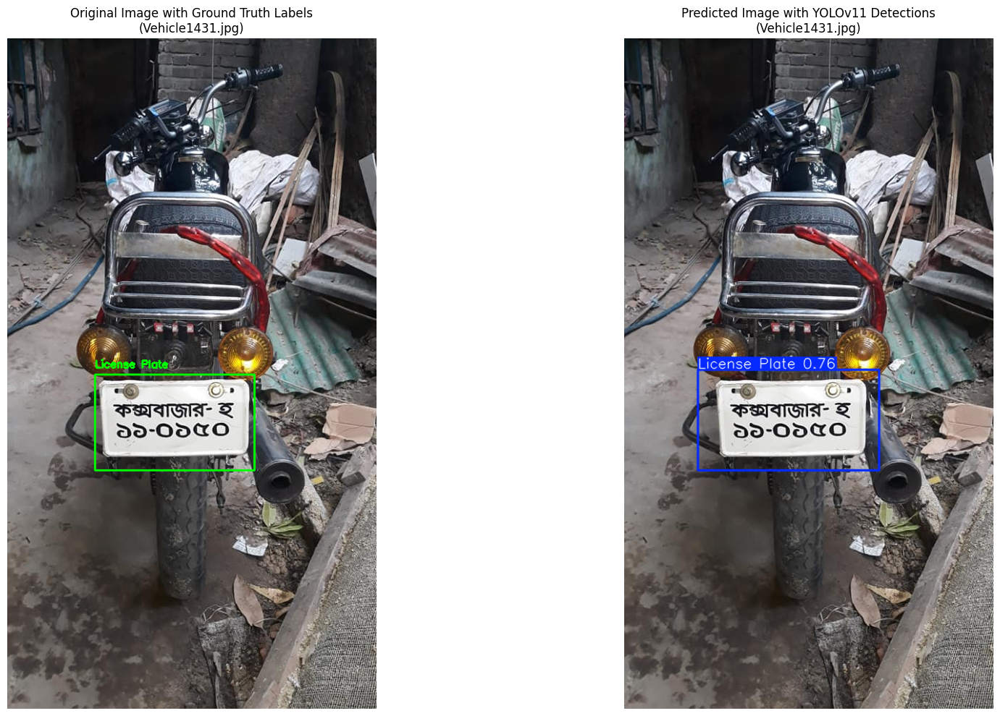


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle334.jpg: 640x480 1 License Plate, 9.8ms
Speed: 1.4ms preprocess, 9.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)


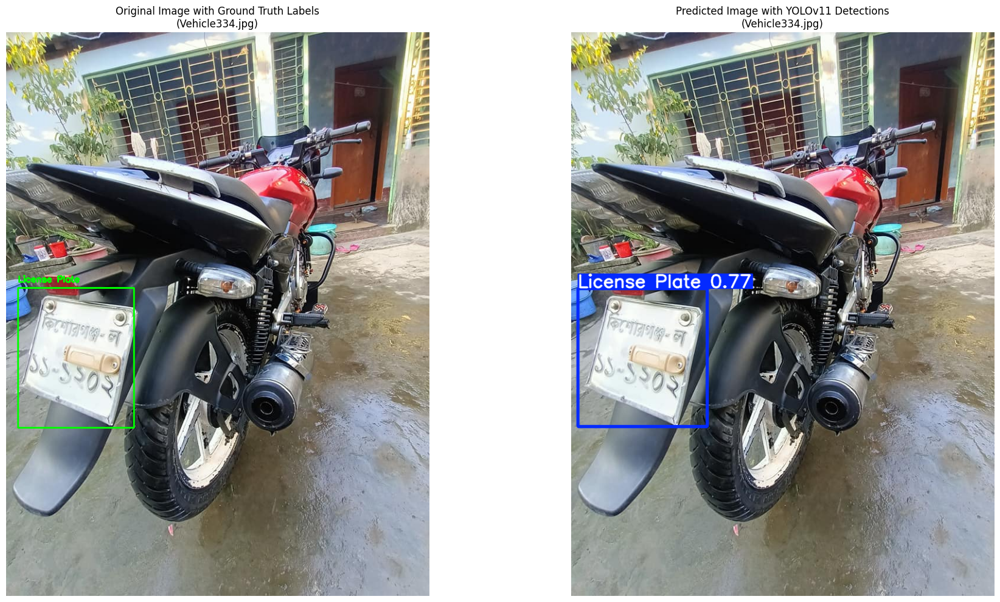


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle572.jpg: 640x480 1 License Plate, 8.0ms
Speed: 1.4ms preprocess, 8.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)


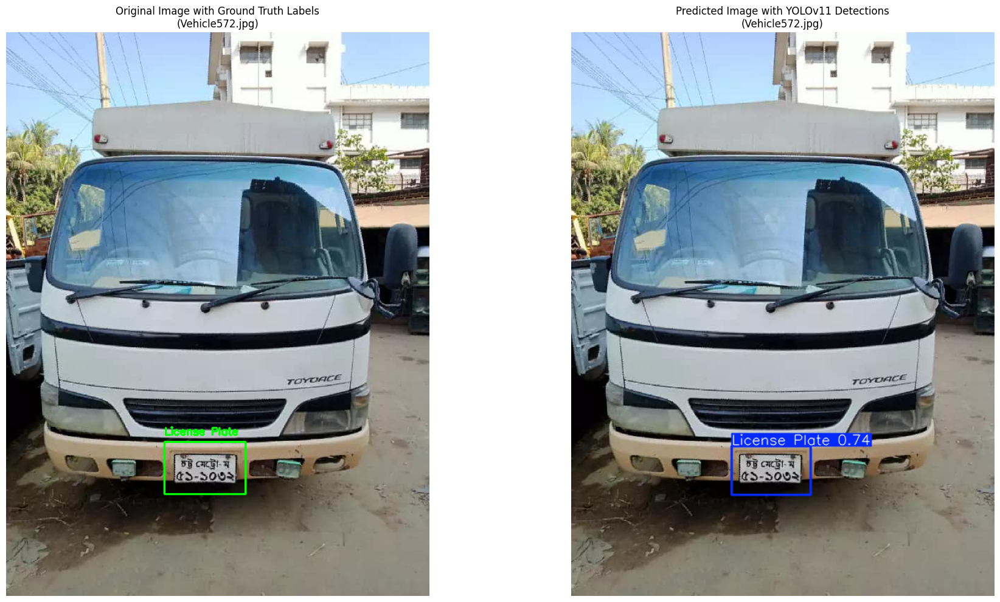


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle521.jpg: 640x480 1 License Plate, 7.8ms
Speed: 1.2ms preprocess, 7.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)


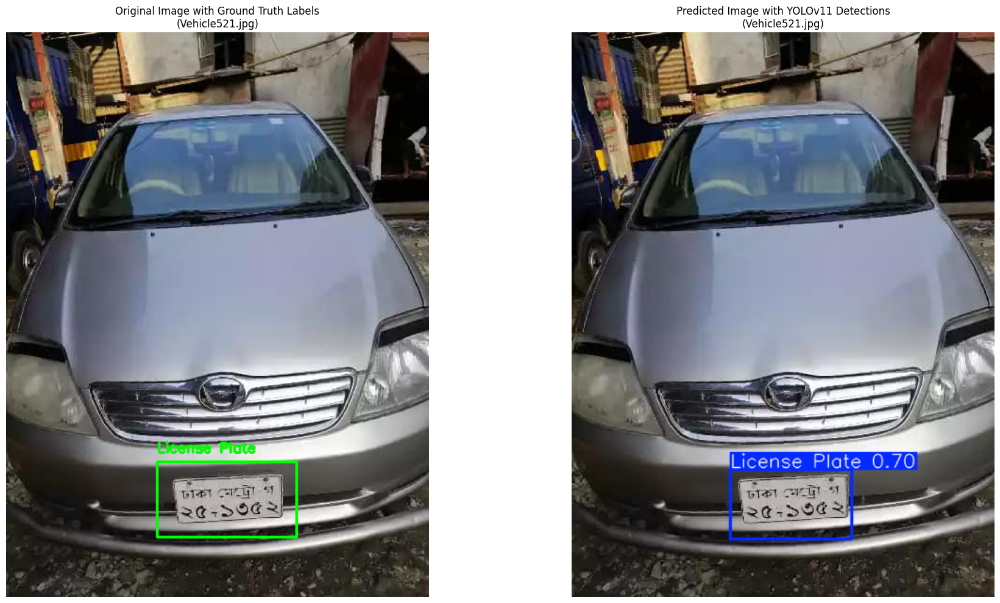


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle625.jpg: 480x640 1 License Plate, 8.8ms
Speed: 1.4ms preprocess, 8.8ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


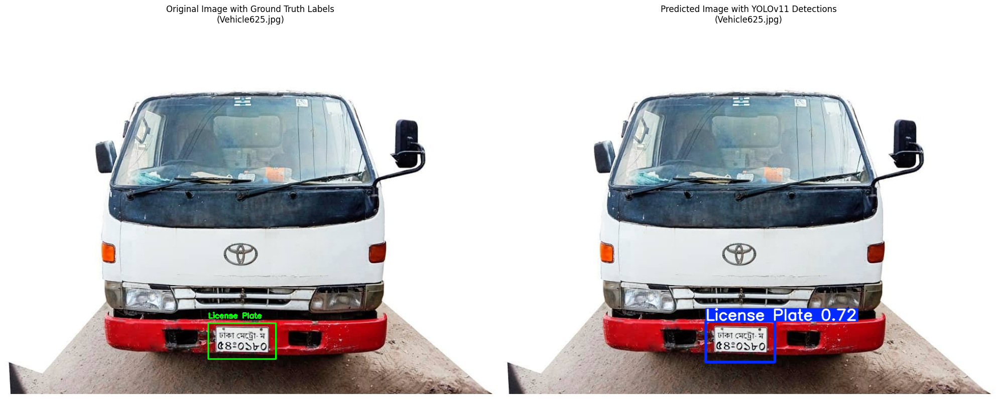


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1303.jpg: 352x640 1 License Plate, 46.4ms
Speed: 0.9ms preprocess, 46.4ms inference, 0.9ms postprocess per image at shape (1, 3, 352, 640)


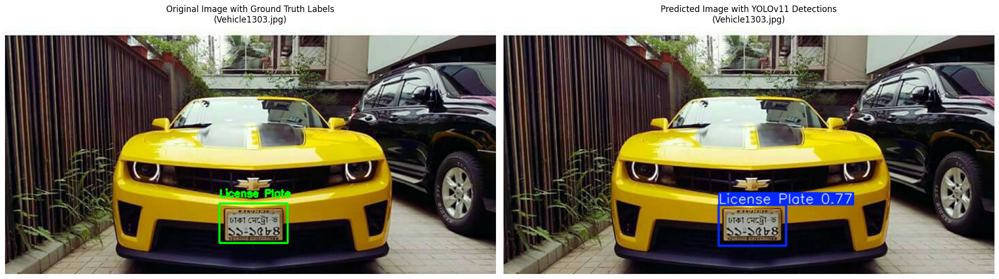


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle903.jpg: 480x640 1 License Plate, 9.2ms
Speed: 1.4ms preprocess, 9.2ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)


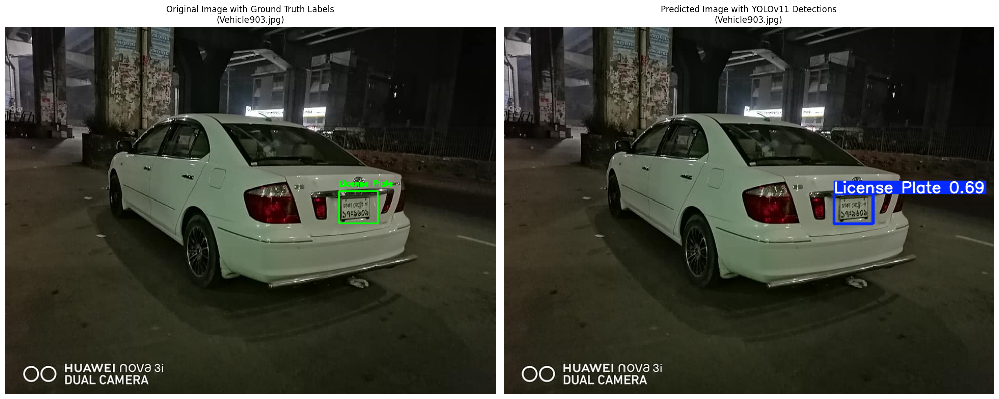


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle959.jpg: 640x480 1 License Plate, 8.3ms
Speed: 1.4ms preprocess, 8.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)


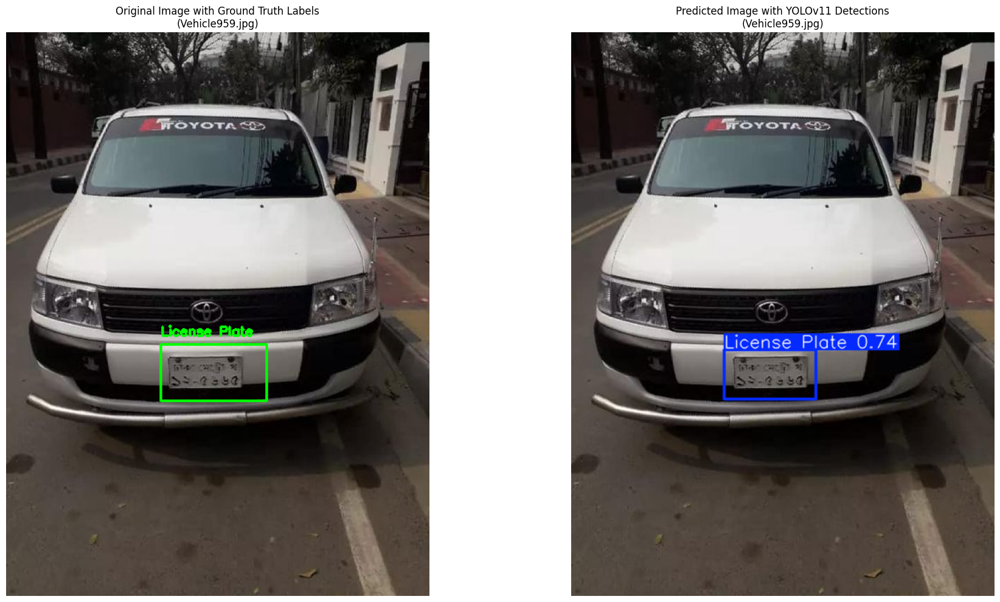


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1145.jpg: 480x640 1 License Plate, 8.0ms
Speed: 0.9ms preprocess, 8.0ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


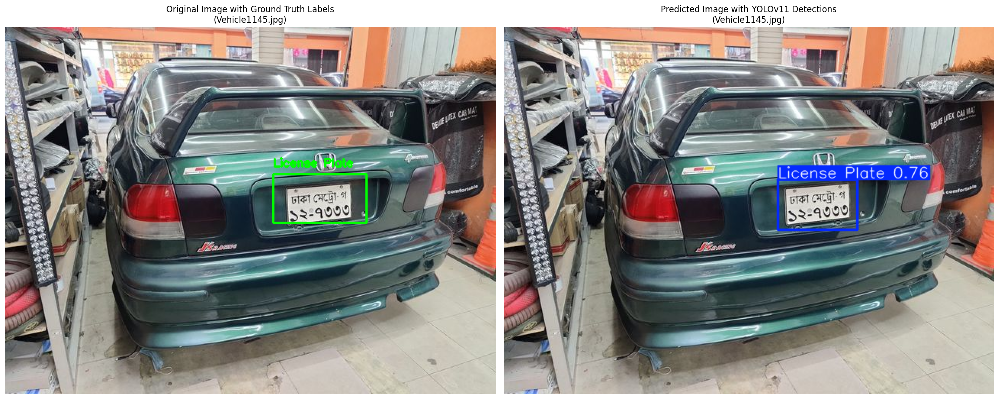


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1134.jpg: 640x480 1 License Plate, 8.9ms
Speed: 0.9ms preprocess, 8.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)


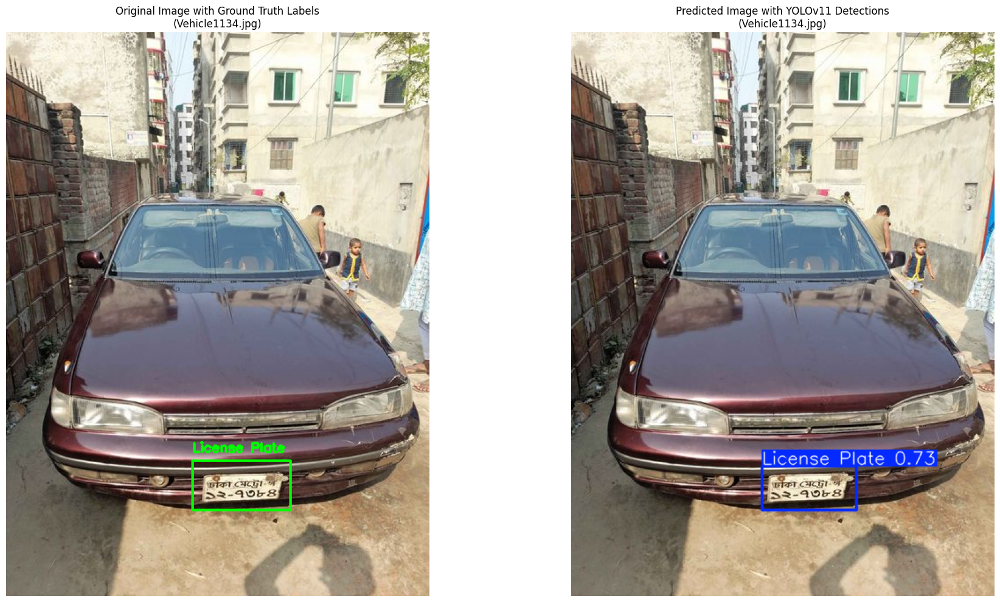


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1243.jpg: 448x640 1 License Plate, 53.4ms
Speed: 1.3ms preprocess, 53.4ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)


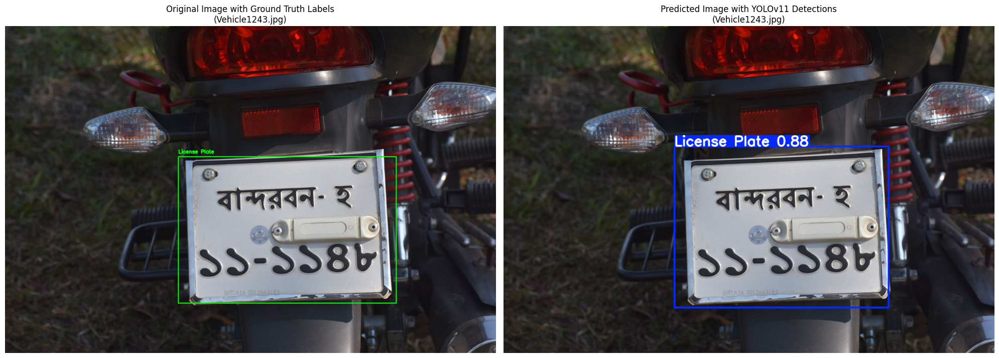


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1043.jpg: 640x320 1 License Plate, 9.1ms
Speed: 1.1ms preprocess, 9.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 320)


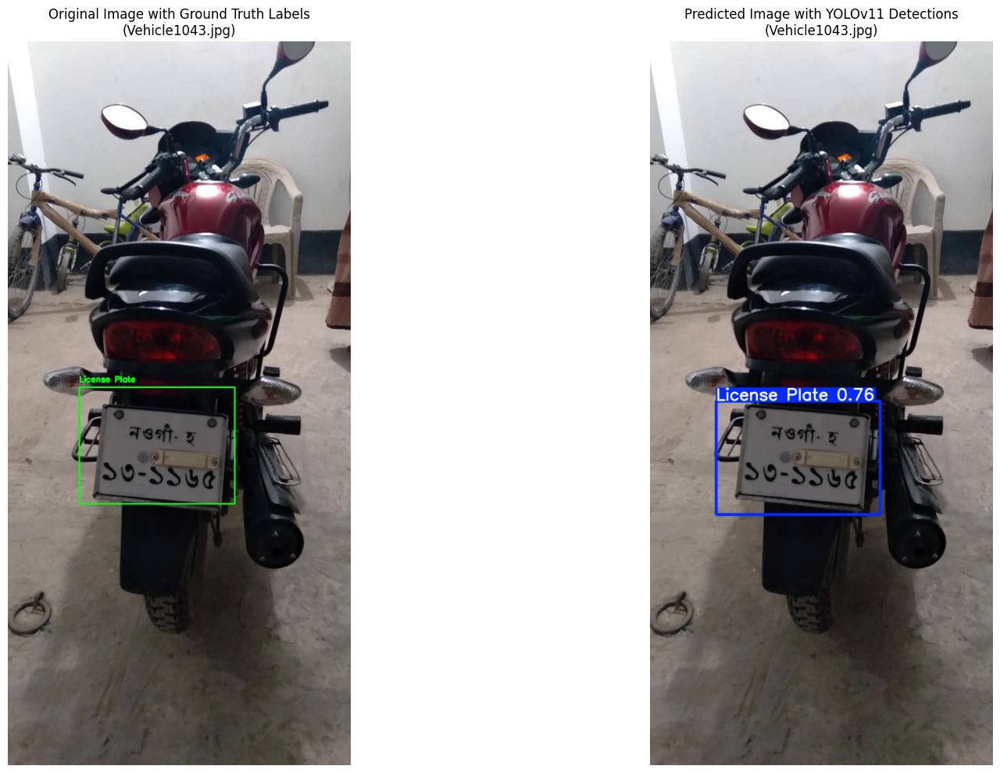


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle515.jpg: 640x384 1 License Plate, 47.5ms
Speed: 1.1ms preprocess, 47.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


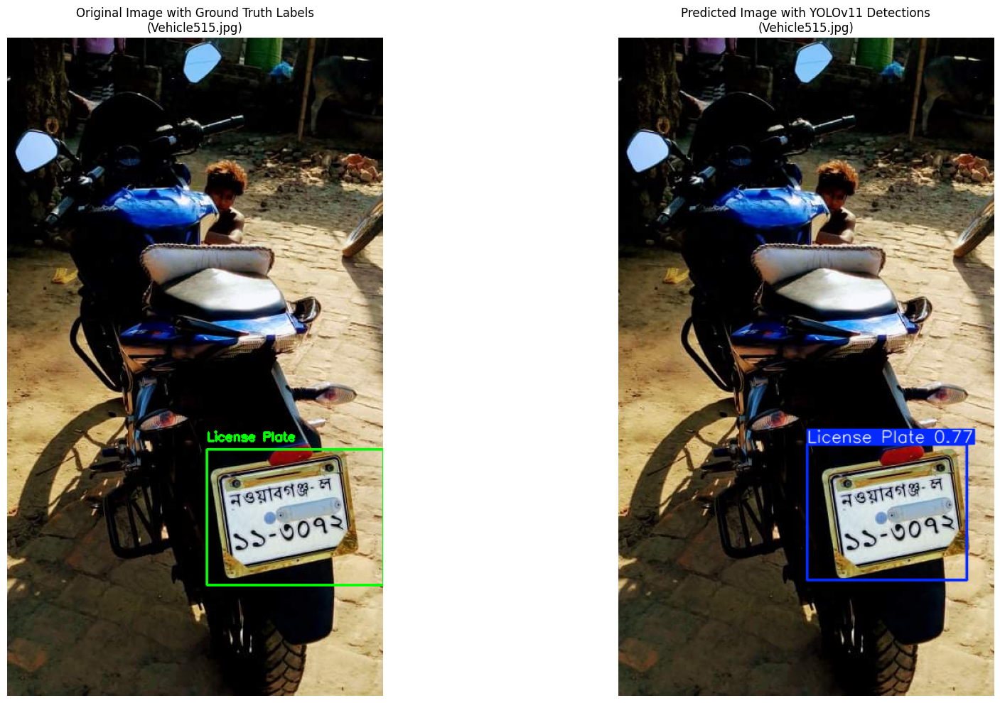


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1172.jpg: 640x480 1 License Plate, 9.0ms
Speed: 1.6ms preprocess, 9.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)


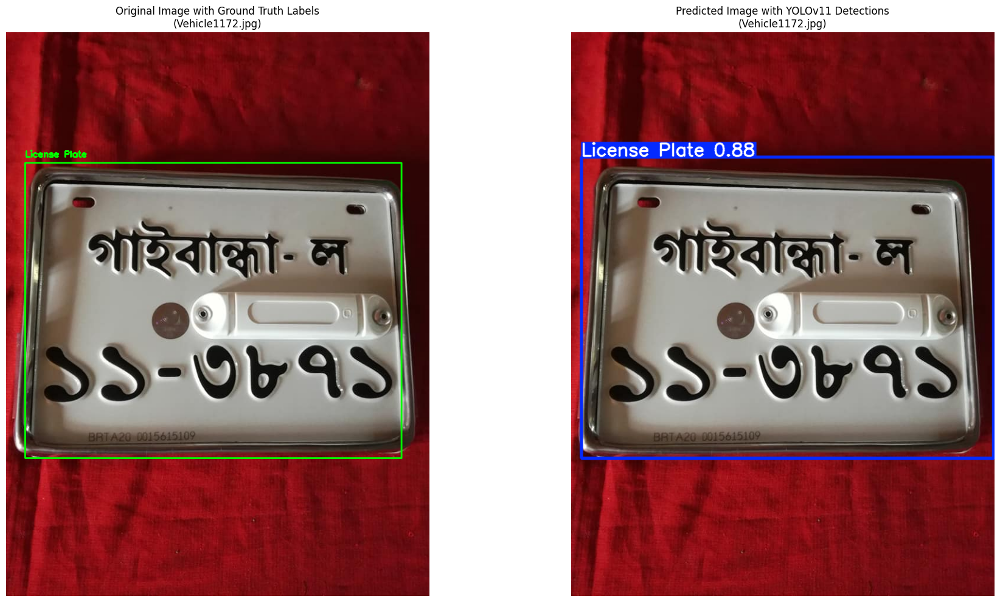


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1370.jpg: 384x640 1 License Plate, 8.2ms
Speed: 1.0ms preprocess, 8.2ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


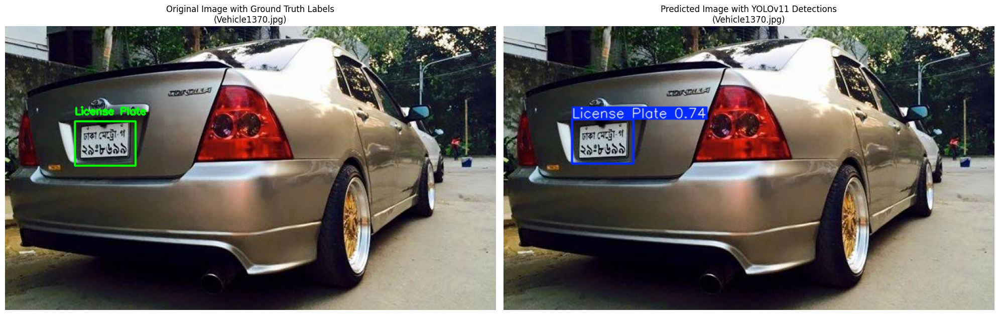


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1641.jpg: 576x640 1 License Plate, 9.2ms
Speed: 1.7ms preprocess, 9.2ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)


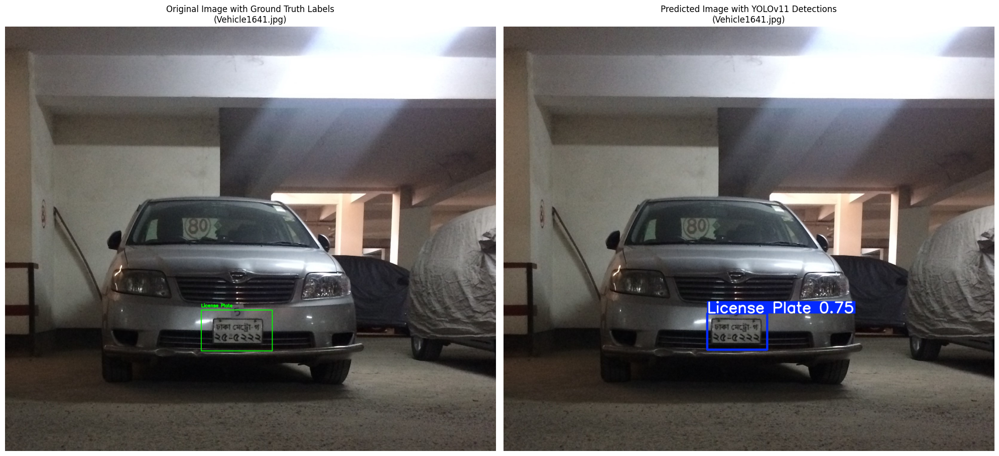


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1854.jpeg: 640x480 1 License Plate, 9.2ms
Speed: 1.4ms preprocess, 9.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)


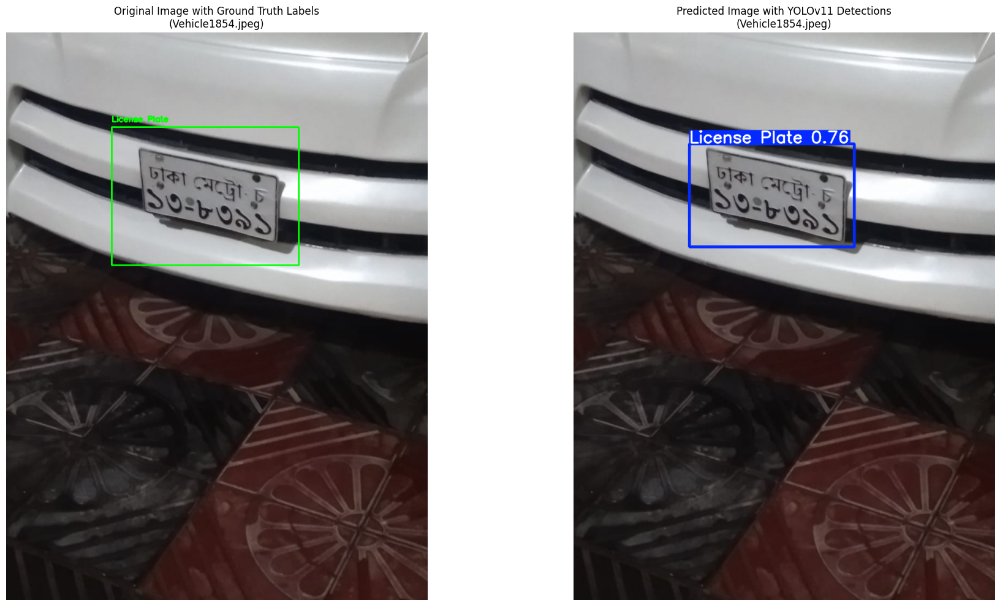


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle312.jpg: 640x480 2 License Plates, 7.8ms
Speed: 0.8ms preprocess, 7.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)


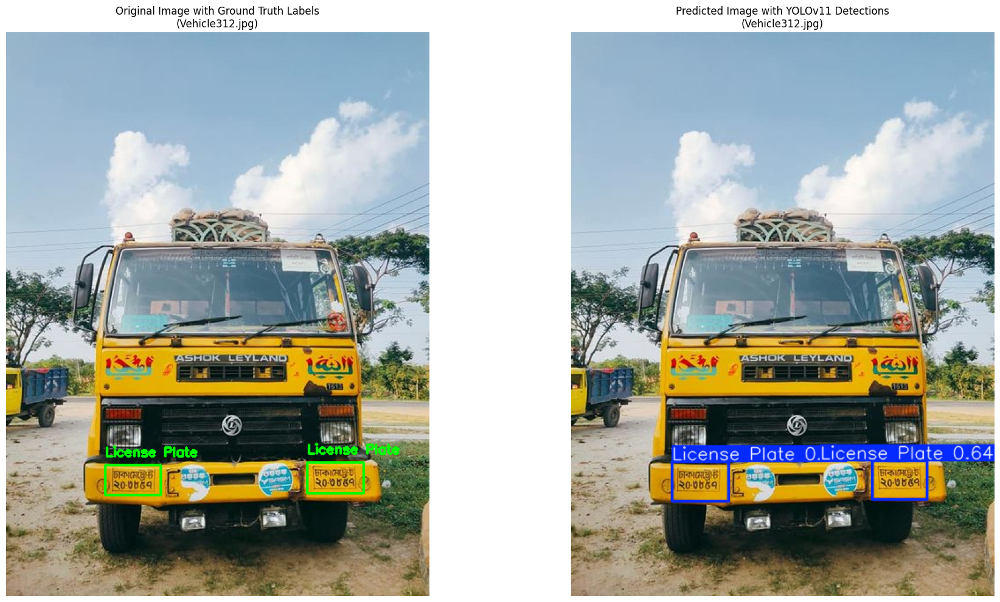


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle607.jpg: 640x320 1 License Plate, 8.5ms
Speed: 0.9ms preprocess, 8.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 320)


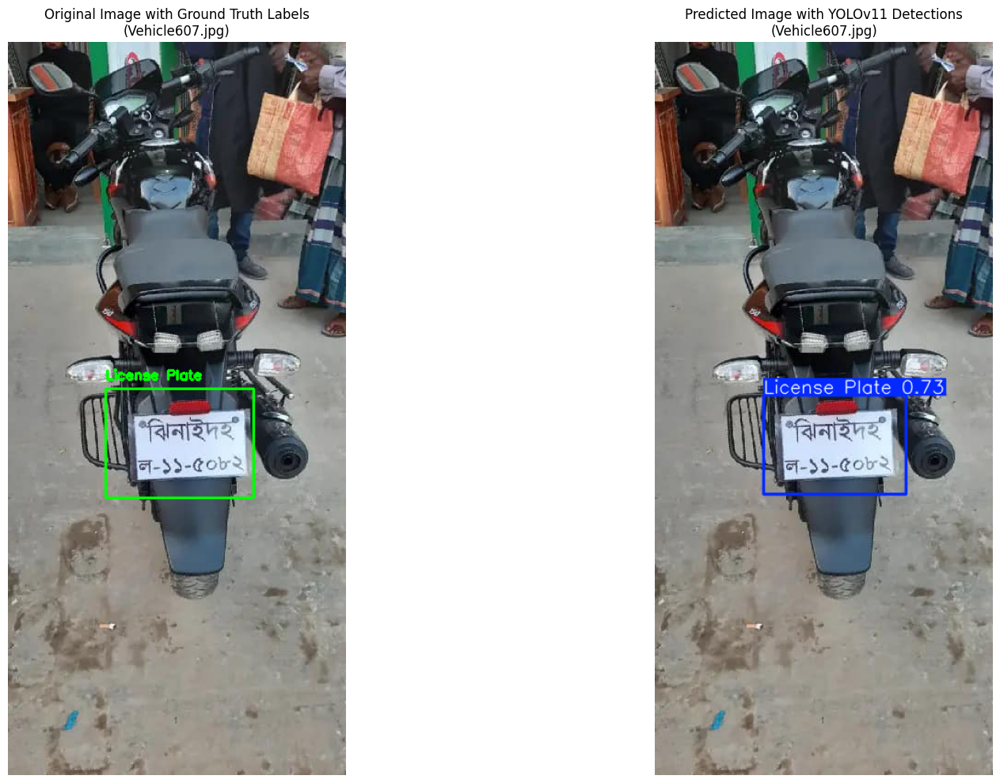


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1680.jpg: 480x640 1 License Plate, 8.4ms
Speed: 1.8ms preprocess, 8.4ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


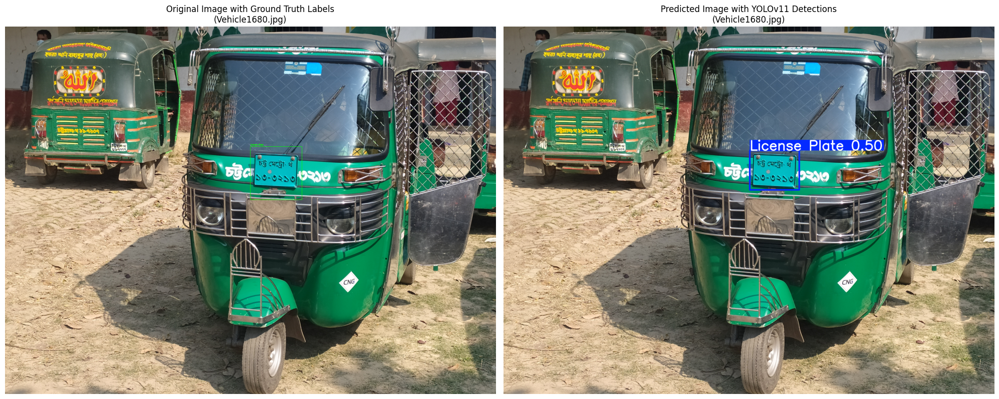


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle514.jpg: 640x480 1 License Plate, 8.1ms
Speed: 1.4ms preprocess, 8.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)


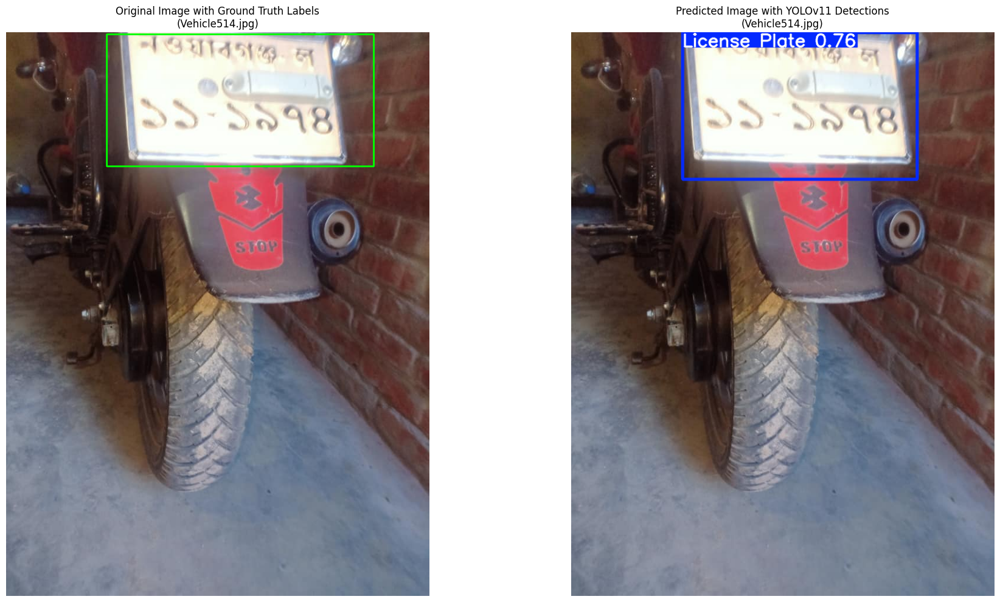


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle1697.jpg: 640x480 1 License Plate, 8.0ms
Speed: 1.7ms preprocess, 8.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)


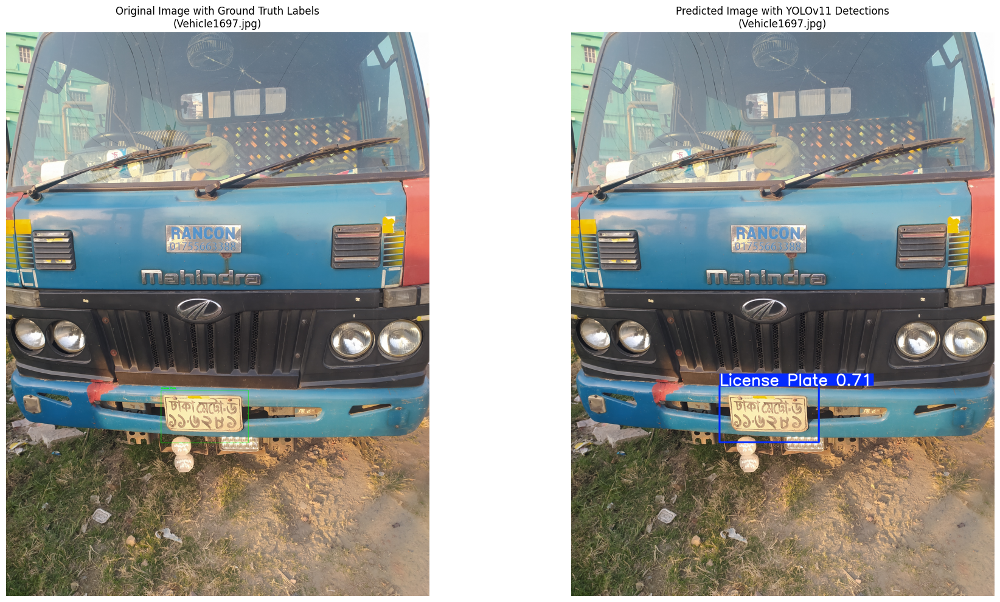


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle701.jpg: 640x480 1 License Plate, 7.8ms
Speed: 1.3ms preprocess, 7.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)


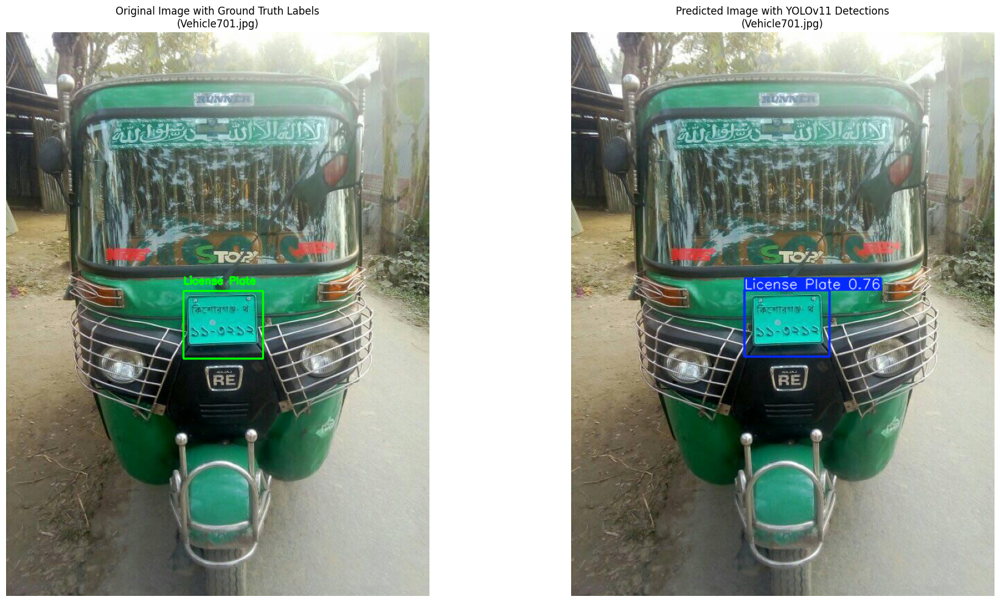


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle413.jpg: 640x480 1 License Plate, 8.6ms
Speed: 1.8ms preprocess, 8.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)


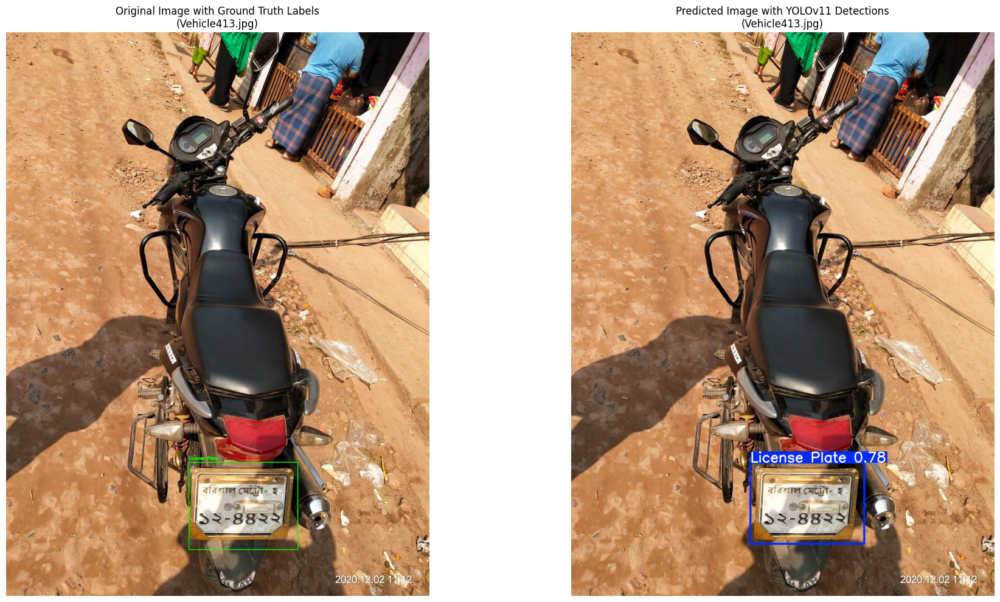


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle396.jpg: 320x640 2 License Plates, 12.6ms
Speed: 1.7ms preprocess, 12.6ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 640)


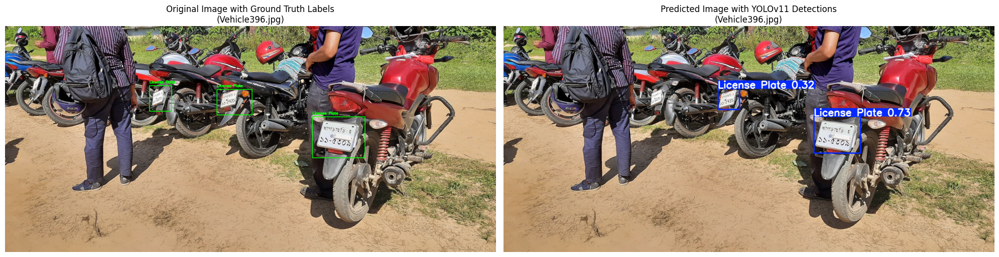


image 1/1 /mnt/Common/Code/Model Training/Nowshin/Bengali License Plate Detection/dataset/img-to-numplate/test/images/Vehicle133.jpg: 640x384 1 License Plate, 8.2ms
Speed: 0.8ms preprocess, 8.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)


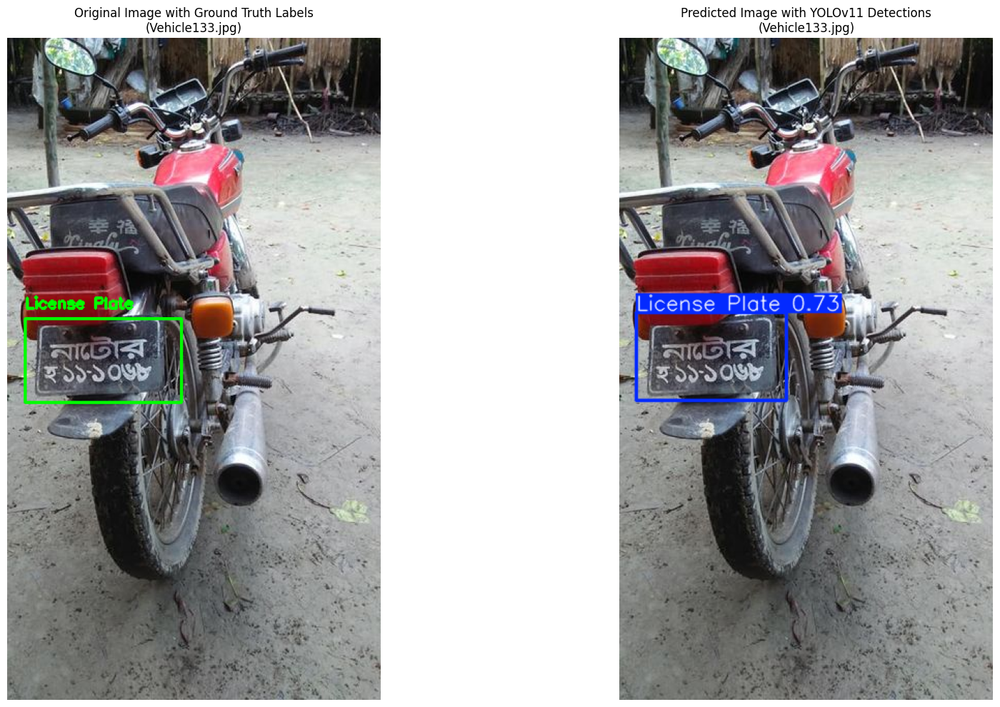

In [17]:
%matplotlib inline
for img_path in test_image_files:
    img_filename = os.path.basename(img_path)
    img_name_no_ext = os.path.splitext(img_filename)[0]
    label_path = os.path.join(TEST_LABELS_DIR, img_name_no_ext + '.txt')

    original_image = cv2.imread(img_path)
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

    ground_truth_annotations = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = list(map(float, line.strip().split()))
                ground_truth_annotations.append(parts)

    ground_truth_image_display = draw_annotations(original_image.copy(), ground_truth_annotations, class_names, color=(0, 255, 0), is_gt=True)

    prediction_results = trained_model.predict(
        source=img_path,
        imgsz=IMG_SIZE,
        conf=CONF_THRESHOLD,
        # iou=IOU_THRESHOLD,
        # save=True,
        # save_txt=True,
        project=PREDICT_PROJECT_NAME,
        name=PREDICT_RUN_NAME,
        exist_ok=True
    )

    predicted_image_path_in_runs = os.path.join(PREDICT_PROJECT_NAME, PREDICT_RUN_NAME, img_filename)

    if os.path.exists(predicted_image_path_in_runs):
        predicted_image_display = cv2.imread(predicted_image_path_in_runs)
        predicted_image_display = cv2.cvtColor(predicted_image_display, cv2.COLOR_BGR2RGB)
    else:
        print(f"Warning: Predicted image not found at {predicted_image_path_in_runs}. Plotting from results.")
        if prediction_results:
            r = prediction_results[0]
            im_np = r.plot()
            predicted_image_display = cv2.cvtColor(im_np, cv2.COLOR_BGR2RGB)
        else:
            predicted_image_display = np.zeros_like(original_image)

    fig, axes = plt.subplots(1, 2, figsize=(20, 10))
    axes[0].imshow(ground_truth_image_display)
    axes[0].set_title(f'Original Image with Ground Truth Labels\n({img_filename})')
    axes[0].axis('off')

    axes[1].imshow(predicted_image_display)
    axes[1].set_title(f'Predicted Image with YOLOv11 Detections\n({img_filename})')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()